In [10]:
import genericIO
import Hypercube
import SepVector 
import numpy as np
from bokeh.io import output_notebook
io=genericIO.io("SEP")
vec=io.getVector("/home/jovyan/data/bay.H")

def createImage(vec,styleOpts={},plotOpts={}):
    """Additional options to backend
    
       transp- Transpose data (True)
       bclip,eclip - Clip values
       bpclip[1],epclip[99] - Clip percentiles (if bclip,eclip not set)
       pclip - Clip percentile [98] (if bpclip,epclip not set)
       Defaults:
            yreverse =True
            cmap="gist_gray"
            """
    axes=vec.getHyper().axes
    mn1=axes[1].o
    if not "invert_yaxis" in plotOpts:
        plotOpts["invert_yaxis"]=True  
    if not "transpose" in plotOpts:
        plotOpts["transpose"]=True
        
    if not "label1" in plotOpts:
        plotOpts["label1"]=axes[0].label
    if not "label2" in plotOpts:
        plotOpts["label2"] =axes[1].label
        
    if plotOpts["transpose"]:
        ar=np.transpose(vec.getNdArray())
        mx1=axes[1].o+axes[1].d*axes[1].n
        mx2=axes[0].o+axes[0].d*axes[0].n
        mn2=axes[0].o
        if not "xlabel" in plotOpts:
            plotOpts["xlabel"]=plotOpts["label2"]
        if not "ylabel" in plotOpts:
            plotOpts["ylabel"]=plotOpts["label1"]
    else:
        ar=vec.getNdArray()
        mn1=axes[0].o
        mx1=axes[0].o+axes[0].d*axes[0].n
        mx2=axes[1].o+axes[1].d*axes[1].n
        mn2=axes[1].o
        if not "xlabel" in plotOpts:
            plotOpts["xlabel"]=plotOpts["label1"]
        if not "ylabel" in plotOpts:
            plotOpts["ylabel"]=plotOpts["label2"] 
    bClip=None
    eClip=None
    if  "bclip" in plotOpts:
        bClip=float(plotOpts["bclip"])
    if "eclip" in plotOpts:
        eClip=float(plotOpts["eclip"])
    if bClip==None and "bpclip" in plotOpts:
        bClip=np.percentile(ar,float(plotOpts["bpclip"]))
    elif bClip==None and "eclip" in plotOpts:
        bClip=np.percentile(ar,0.)
    if eClip==None and "epclip" in plotOpts:
        eClip=np.percentile(ar,float(plotOpts["epclip"]))
    elif eClip==None and "bclip" in plotOpts:
        eClip=np.percentile(ar,100.)
    elif eClip==None and bClip==None:
        ar2=np.absolute(ar)
        pclip=98
        if "pclip" in plotOpts:
            pclip=plotOpts["pclip"]
        eClip=np.percentile(ar2,pclip)
        bClip=-eClip

    if not "cmap" in styleOpts:
        styleOpts["cmap"]="gist_gray"
    img=hv.Image(ar,bounds=[mn1,mn2,mx2,mx2]).opts(style=styleOpts,plot=plotOpts)
    return img.redim.range(z=(bClip,eClip))


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
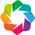

:Image   [x,y]   (z)

In [11]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh','matplotlib')
img=createImage(vec,plotOpts=dict(height=300,width=300,show_grid=True,title="test"),styleOpts=dict(show_grid=True))
img


In [49]:
ls  = np.linspace(0, 10, 100)
x,y = np.meshgrid(ls, ls)
img = hv.Image(np.sin(x)*np.cos(y)+0.1*np.random.rand(100,100), 
               bounds=(-20,-20,20,20)).opts(colorbar=False, xaxis=None, yaxis=None)
colormaps = hv.plotting.list_cmaps()
colormaps2=[]
colormaps2=colormaps[::2]
hv.Layout([img.relabel(c).opts(cmap=c) for c in colormaps2]).cols(3)

:Layout
   .Image.Accent           :Image   [x,y]   (z)
   .Image.Afmhot           :Image   [x,y]   (z)
   .Image.Autumn           :Image   [x,y]   (z)
   .Image.Binary           :Image   [x,y]   (z)
   .Image.Blues            :Image   [x,y]   (z)
   .Image.Bone             :Image   [x,y]   (z)
   .Image.BrBG             :Image   [x,y]   (z)
   .Image.Brg              :Image   [x,y]   (z)
   .Image.BuGn             :Image   [x,y]   (z)
   .Image.BuPu             :Image   [x,y]   (z)
   .Image.Bwr              :Image   [x,y]   (z)
   .Image.Category10       :Image   [x,y]   (z)
   .Image.Category20       :Image   [x,y]   (z)
   .Image.Category20b      :Image   [x,y]   (z)
   .Image.Category20c      :Image   [x,y]   (z)
   .Image.Cividis          :Image   [x,y]   (z)
   .Image.Cividis_r        :Image   [x,y]   (z)
   .Image.CMRmap           :Image   [x,y]   (z)
   .Image.Colorblind       :Image   [x,y]   (z)
   .Image.Cool             :Image   [x,y]   (z)
   .Image.Coolwarm         :Image   [x,y]   (z)
   .Image.Copper           :Image   [x,y]   (z)
   .Image.Cubehelix        :Image   [x,y]   (z)
   .Image.Dark2            :Image   [x,y]   (z)
   .Image.Fire             :Image   [x,y]   (z)
   .Image.Flag             :Image   [x,y]   (z)
   .Image.Gist_earth       :Image   [x,y]   (z)
   .Image.Gist_gray        :Image   [x,y]   (z)
   .Image.Gist_heat        :Image   [x,y]   (z)
   .Image.Gist_ncar        :Image   [x,y]   (z)
   .Image.Gist_rainbow     :Image   [x,y]   (z)
   .Image.Gist_stern       :Image   [x,y]   (z)
   .Image.Gist_yarg        :Image   [x,y]   (z)
   .Image.GnBu             :Image   [x,y]   (z)
   .Image.Gnuplot          :Image   [x,y]   (z)
   .Image.Gnuplot2_r       :Image   [x,y]   (z)
   .Image.Gray             :Image   [x,y]   (z)
   .Image.Greens           :Image   [x,y]   (z)
   .Image.Greys            :Image   [x,y]   (z)
   .Image.Hot              :Image   [x,y]   (z)
   .Image.Hsv              :Image   [x,y]   (z)
   .Image.Inferno          :Image   [x,y]   (z)
   .Image.Inferno_r        :Image   [x,y]   (z)
   .Image.Jet              :Image   [x,y]   (z)
   .Image.Magma            :Image   [x,y]   (z)
   .Image.Magma_r          :Image   [x,y]   (z)
   .Image.Nipy_spectral    :Image   [x,y]   (z)
   .Image.Ocean            :Image   [x,y]   (z)
   .Image.Oranges          :Image   [x,y]   (z)
   .Image.OrRd             :Image   [x,y]   (z)
   .Image.Paired           :Image   [x,y]   (z)
   .Image.Pastel1          :Image   [x,y]   (z)
   .Image.Pastel2          :Image   [x,y]   (z)
   .Image.Pink             :Image   [x,y]   (z)
   .Image.PiYG             :Image   [x,y]   (z)
   .Image.Plasma           :Image   [x,y]   (z)
   .Image.Plasma_r         :Image   [x,y]   (z)
   .Image.PRGn             :Image   [x,y]   (z)
   .Image.Prism            :Image   [x,y]   (z)
   .Image.PuBu             :Image   [x,y]   (z)
   .Image.PuBuGn           :Image   [x,y]   (z)
   .Image.PuOr             :Image   [x,y]   (z)
   .Image.PuRd             :Image   [x,y]   (z)
   .Image.Purples          :Image   [x,y]   (z)
   .Image.Rainbow          :Image   [x,y]   (z)
   .Image.RdBu             :Image   [x,y]   (z)
   .Image.RdGy             :Image   [x,y]   (z)
   .Image.RdPu             :Image   [x,y]   (z)
   .Image.RdYlBu           :Image   [x,y]   (z)
   .Image.RdYlGn           :Image   [x,y]   (z)
   .Image.Reds             :Image   [x,y]   (z)
   .Image.Seismic          :Image   [x,y]   (z)
   .Image.Set1             :Image   [x,y]   (z)
   .Image.Set2             :Image   [x,y]   (z)
   .Image.Set3             :Image   [x,y]   (z)
   .Image.Spectral         :Image   [x,y]   (z)
   .Image.Spring           :Image   [x,y]   (z)
   .Image.Summer           :Image   [x,y]   (z)
   .Image.Tab10            :Image   [x,y]   (z)
   .Image.Tab20            :Image   [x,y]   (z)
   .Image.Tab20b           :Image   [x,y]   (z)
   .Image.Tab20c           :Image   [x,y]   (z)
   .Image.Terrain          :Image   [x,y]   (z)
   .Imag

In [26]:
colormaps = hv.plotting.list_cmaps()
print(colormaps)

['Accent', 'Accent_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'Blues', 'Blues_r', 'bone', 'bone_r', 'BrBG', 'BrBG_r', 'brg', 'brg_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'bwr', 'bwr_r', 'Category10', 'Category10_r', 'Category20', 'Category20_r', 'Category20b', 'Category20b_r', 'Category20c', 'Category20c_r', 'cividis', 'Cividis', 'Cividis_r', 'cividis_r', 'CMRmap', 'CMRmap_r', 'Colorblind', 'Colorblind_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'cubehelix', 'cubehelix_r', 'Dark2', 'Dark2_r', 'fire', 'fire_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'GnBu', 'GnBu_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'Inferno', 'inferno', 'Inferno_r', 'inferno_r',

In [51]:
import numpy as np
import holoviews as hv

from bokeh.io import curdoc
from bokeh.layouts import layout
from bokeh.models import Slider, Button

renderer = hv.renderer('bokeh')
# Declare the HoloViews object
start = 0
end = 10
hmap = hv.HoloMap({i: hv.Image(np.random.rand(10,10)) for i in range(start, end+1)})

# Convert the HoloViews object into a plot
plot = renderer.get_plot(hmap)

def animate_update():
    year = slider.value + 1
    if year > end:
        year = start
    slider.value = year

def slider_update(attrname, old, new):
    plot.update(slider.value)

slider = Slider(start=start, end=end, value=0, step=1, title="Year")
slider.on_change('value', slider_update)

def animate():
    if button.label == '► Play':
        button.label = '❚❚ Pause'
        curdoc().add_periodic_callback(animate_update, 200)
    else:
        button.label = '► Play'
        curdoc().remove_periodic_callback(animate_update)

button = Button(label='► Play', width=60)
button.on_click(animate)

# Combine the bokeh plot on plot.state with the widgets
layout = layout([
    [plot.state],
    [slider, button],
], sizing_mode='fixed')

curdoc().add_root(layout)

In [54]:

def sine_curve(phase, freq):
    xvals = [0.1* i for i in range(100)]
    return hv.Curve((xvals, [np.sin(phase+freq*x) for x in xvals]))

# When run live, this cell's output should match the behavior of the GIF below
dmap = hv.DynamicMap(sine_curve, kdims=['phase', 'frequency'])
dmap.redim.range(phase=(0.2,1)).redim.range(frequency=(0.4,1.25))


:DynamicMap   [phase,frequency]
   :Curve   [x]   (y)